# Imports and Definitions

In [90]:
import plotly.graph_objects as go
from PIL import Image
import plotly.express as px
import pandas as pd
import os
import numpy as np
from itertools import cycle
import moviepy.editor as mpy
from sklearn.tree import DecisionTreeRegressor
from matplotlib import pyplot as plt

In [2]:
def load_image():
    img = Image.open("./data/mars.png")
    rgbimg = Image.new("RGBA", img.size)
    rgbimg.paste(img)
    return rgbimg

img = load_image()

# Overview
This ipython notebook will be used to take analytical notes and to build out ideas with code to graph things in support of them. I will be writing things in markdown, which we can then reword in a paper.

# Finding the Best Agent

## Rational
In order to determine what traits were the most helpful for the AI, we're going to want to rank all of the agents based on their performance. However, performance can vary wildly between starting positions, so we need to remove starting position from the equation. The best way to do that is to take each agent and find the average path variance over all starting positions. This will be their overall score, and we will rank them accordingly.

In [54]:
# Gets the average results for all agents across all locations
base = "./results_param/"

df_agents = pd.DataFrame(columns = ["agent", "apv"])

loc_dirs = [x for x in os.listdir(base) if "." not in x]

for location in loc_dirs:
    agent_dirs = os.listdir(os.path.join(base, location))

    for agent in agent_dirs:
        agent_name = "_".join(agent.split("_")[:-4])

        apv = pd.read_csv(os.path.join(base, location, agent, "avg_path_variance.csv"), names=['apv']).apv[0]
        df_agents = df_agents.append({"agent": agent_name, 'apv': apv}, ignore_index=True)

In [55]:
df_ranked_agents_mean = df_agents.groupby('agent').mean().sort_values('apv', ascending=False)
df_ranked_agents_mean['agent'] = df_ranked_agents_mean['apv'].index
df_ranked_agents_mean.index = range(len(df_ranked_agents_mean))
print("Agents sorted by mean:")
print(df_ranked_agents_mean.to_string())

Agents sorted by mean:
          apv                                                                           agent
0    0.066039      Curiosity_Prob1.0_Brain_CircMem_Mem100_ImgSize64_NovMSE_Train3_Lrate0.0003
1    0.064748       Curiosity_Prob1.0_Brain_CircMem_Mem80_ImgSize64_NovMSE_Train3_Lrate0.0001
2    0.064595      Curiosity_Prob1.0_Brain_CircMem_Mem100_ImgSize64_NovMAE_Train2_Lrate0.0004
3    0.064380       Curiosity_Prob1.0_Brain_CircMem_Mem40_ImgSize64_NovMAE_Train3_Lrate0.0004
4    0.064029      Curiosity_Prob1.0_Brain_CircMem_Mem100_ImgSize64_NovMSE_Train2_Lrate0.0002
5    0.063832      Curiosity_Prob1.0_Brain_CircMem_Mem100_ImgSize64_NovMSE_Train2_Lrate0.0004
6    0.063327       Curiosity_Prob1.0_Brain_CircMem_Mem60_ImgSize64_NovMSE_Train3_Lrate0.0003
7    0.062535       Curiosity_Prob1.0_Brain_CircMem_Mem60_ImgSize64_NovMSE_Train2_Lrate0.0004
8    0.062304       Curiosity_Prob1.0_Brain_CircMem_Mem40_ImgSize64_NovMSE_Train3_Lrate0.0003
9    0.061999       Curiosity_Prob1.0

## Analysis
### Curious Agents vs Reference Agents
If we look at the code output, we see that we have multiple agents that improve over the Linear agent, and almost half of our agents are better than the Random agent. This is much better than either of our original trials. We can also see that the best Curious agent has an average variance that is approximately 0.02 higher than that of the linear agent. If we take the difference between the best agent and the linear agent, and the difference between the best agent and the worst agent, then find the ratio between the two, we come up with the following equation.

$\frac{0.066039 - 0.061739}{0.066039 - 0.020553} = 0.09453458207$

This shows that the difference between the best agent and the linear agent is about 10% of the difference between the best agent and the worst agent. If we use the following code, we can see that this means that the best agent is almost an entire standard deviation above the Linear agent, while the linear agent is only 1.5 standard deviations from the mean.

In [48]:
print('Mean:', df_ranked_agents.mean().apv)
print("Standard Deviation:", df_ranked_agents.std().apv)
linear_apv = float(df_ranked_agents.loc[df_ranked_agents['agent'] == 'Linear'].apv)
print('Linear Agent, Standard Deviations from the Mean', (linear_apv - df_ranked_agents.mean().apv)/df_ranked_agents.std().apv)

Mean: 0.043317734249213265
Standard Deviation: 0.01194166977559794
Linear Agent, Standard Deviations from the Mean 1.5425744251074474


However, if we look at the variance of each model, we can see that the random agents generally have a much higher variance in performance than the Linear and Random Agents. This is not ideal for exploration, and should be addressed.

In [56]:
df_ranked_agents_var = df_agents.groupby('agent').var().sort_values('apv', ascending=False)
df_ranked_agents_var['agent'] = df_ranked_agents_var['apv'].index
df_ranked_agents_var.index = range(len(df_ranked_agents_var))
print("Agents sorted by variance:")
print(df_ranked_agents_var.to_string())

Agents sorted by variance:
          apv                                                                           agent
0    0.000721       Curiosity_Prob1.0_Brain_CircMem_Mem40_ImgSize64_NovMSE_Train3_Lrate0.0004
1    0.000691       Curiosity_Prob1.0_Brain_CircMem_Mem60_ImgSize64_NovMSE_Train1_Lrate0.0002
2    0.000656   Curiosity_Prob1.0_Brain_PriorityMem_Mem40_ImgSize64_NovMSE_Train1_Lrate0.0001
3    0.000645       Curiosity_Prob1.0_Brain_CircMem_Mem20_ImgSize64_NovMSE_Train3_Lrate0.0002
4    0.000632  Curiosity_Prob1.0_Brain_PriorityMem_Mem100_ImgSize64_NovMAE_Train1_Lrate0.0002
5    0.000611   Curiosity_Prob1.0_Brain_PriorityMem_Mem40_ImgSize64_NovMSE_Train3_Lrate0.0003
6    0.000611  Curiosity_Prob1.0_Brain_PriorityMem_Mem100_ImgSize64_NovMSE_Train1_Lrate0.0003
7    0.000609       Curiosity_Prob1.0_Brain_CircMem_Mem60_ImgSize64_NovMSE_Train1_Lrate0.0001
8    0.000606   Curiosity_Prob1.0_Brain_PriorityMem_Mem80_ImgSize64_NovMSE_Train3_Lrate0.0003
9    0.000599       Curiosity_Pro

As of now, our curious agents do not have the ability to make long term plans of any sort. They can only move to the area of greatest novelty, as dictated by their auto encoder. Additionally, the agent has a rather limited view of its surroundings. This means that an agent does not have the ability to see into the distance for things that *might* be interesting, and move towards those. Additionally, when encountering an area of low novelty, the agent will appear to wander around in circles as it chooses the most interesting area available to it. However, this causes the agent to become stuck in basins of low novelty with mo method of escape. We can see this in the following graph, which places time on the z-axis:

In [25]:
base = "./results_param"
target_point = 'pos_574_952'
path_record = "path_record.csv"
target_models = [
    'Curiosity_Prob1.0_Brain_CircMem_Mem100_ImgSize64_NovMSE_Train3_Lrate0.0003',
    'Curiosity_Prob1.0_Brain_PriorityMem_Mem20_ImgSize64_NovMAE_Train3_Lrate0.0001',
    'Linear',
    'Random'
]

palette = cycle(px.colors.qualitative.Plotly)

fig = go.Figure()

for m in target_models:
    dirname = '{}_Agent_{}'.format(m, target_point[0].upper() + target_point[1:])
    pr = pd.read_csv(os.path.join(base, target_point, dirname, path_record), names=['x', 'y'])
    fig.add_trace(go.Scatter3d(x=pr.x, y=pr.y, z=list(range(1000)), marker_color=next(palette), mode='lines', name=m, hoverlabel= {'namelength' :-1}))

fig.update_layout(
    title={
        'text': "Agents",
        'xanchor': 'center',
        'yanchor': 'top',
        'y':0.97,
        'x':0.5,
    },
    xaxis_title="X Position",
    yaxis_title="Y Position",
    legend_title={
        'text': "Agents",

    },
    legend={
        'xanchor': 'center',
        'yanchor': 'top',
        'y':-0.2,
        'x':0.5,
    },
    width=1000,
    height=1000
)

fig.show()

The above graph shows us that when a model becomes stuck in a small area, it results in a very small APV. A larger range doesn't necessarily mean a higher APV, but smaller ranges are correlated with smaller APVs. _**Show this**_

For the purposes of this paper, we assume that humans are the ideal explorer, since we're trying to replicate a human's exploratory intuition in this paper. Therefore, we should look at the way that humans explore, and see if we can draw insights for our agents. When a human is in a relatively uninteresting environment with no clear indication of novel phenomenon, they will generaly choose a random direction, and begin walking until they find something novel. Although not very scientific, this is a useful heuristic that allows humans to quickly overcome basins of low novelty, and move into areas of higher interest. This can be a risky move, since decisions are often made seemingly at random. What if the human were to choose exactly the wrong direction? We can reason a few solutions to this problem.

For one, it's usually very unlikely that an uninteresting region will be stretch on infinitly. Eventually, the human will stumble on something interesting. This is good for the average case, but an edge case, like a desert, can delay payoff by weeks (perhapse months for a slow rover). This is obviously something that we want to avoid, and thankfully, humans have two methods for this. One method is backtracking, but this is very costly, and is usually reserved for situations where the agent is lost and needs to find familiar ground. Another solution is choosing a new direction and performing the same task again. By implementing a joint explore-escape algorithm, agents are able to thoroughly explore specific phenomenon, then escape from their generated novelty basin and continue until they find something interesting enough to trigger their explore mode again.

This explore-escape method would explain why the linear agent was able to achieve such high APVs while maintaining a low APV variance. Because it was unable to become stuck in areas of low novelty, the linear agent was able to constantly visit novel areas and did't have to worry about the novelty of its starting position. We hypothesize that this explore-escape method would massively reduce the position-wise variance of our curious agents, while maintaining their high individual APVs. This is corroborated by the code below, which shows the agents sorted by their maximum APV.

In [58]:
df_ranked_agents_max = df_agents.groupby('agent').max().sort_values('apv', ascending=False)
df_ranked_agents_max['agent'] = df_ranked_agents_max['apv'].index
df_ranked_agents_max.index = range(len(df_ranked_agents_max))
print("Agents sorted by max APV:")
print(df_ranked_agents_max.to_string())

Agents sorted by max APV:
          apv                                                                           agent
0    0.115056       Curiosity_Prob1.0_Brain_CircMem_Mem60_ImgSize64_NovMSE_Train2_Lrate0.0004
1    0.113520       Curiosity_Prob1.0_Brain_CircMem_Mem60_ImgSize64_NovMSE_Train1_Lrate0.0002
2    0.107832       Curiosity_Prob1.0_Brain_CircMem_Mem80_ImgSize64_NovMAE_Train1_Lrate0.0002
3    0.107753       Curiosity_Prob1.0_Brain_CircMem_Mem40_ImgSize64_NovMSE_Train3_Lrate0.0004
4    0.106230       Curiosity_Prob1.0_Brain_CircMem_Mem20_ImgSize64_NovMSE_Train3_Lrate0.0002
5    0.105134       Curiosity_Prob1.0_Brain_CircMem_Mem60_ImgSize64_NovMAE_Train1_Lrate0.0003
6    0.104377       Curiosity_Prob1.0_Brain_CircMem_Mem80_ImgSize64_NovMSE_Train3_Lrate0.0003
7    0.103632       Curiosity_Prob1.0_Brain_CircMem_Mem60_ImgSize64_NovMSE_Train3_Lrate0.0002
8    0.101743       Curiosity_Prob1.0_Brain_CircMem_Mem80_ImgSize64_NovMSE_Train1_Lrate0.0003
9    0.100882       Curiosity_Prob

If we consider the max value to be an upper bound of the average value for an explore-escape paradigm (since novelty basins would be removed, elevating the average value), we see that it is possible that the curious agents could vastly outstrip even the Linear agent. Additionally, we note that different models come for the forefront using this metric, meaning that our analysis of highest average APV may be more indicative of an agent's ability to escape a novelty basin than its ability to seek out novelty. However, it could simply be the above agents were lucky, and happened upon a highly lucrative path by chance.

This explore-escape paradigm seems very promising, but is out of the scope of this paper. We believe that this would be an excellent area for future research. It is important to note that this is a proposed *heuristic*, and is not guaranteed to give the ideal solution. Additionally, we have left out many of the important details, such as "how do you determine if you're in a novelty basin", and "how to decide how long to walk in another direction". It may be worthwhile to implement a brain that utilizes Reinforcement Learning with an LSTM to allow for finer directional control than a simple argmax function, as well as memory to allow the curious agent to decide for itself the best method for escaping the novelty basin.

However, we would be remiss to mention that heuristics developed in a lab will not necessarily be transferable to the real world. Additionally, we can't just throw an agent into the real world and have them learn there. This cost too much time and money to be reasonable. Instead, we need a technique through which the agent can augment its own experience. If we again look at humans, we see that they often augment their own experiences by imagining scenarious and planning out actions before they are confronted with those situations in real life. This enables faster reactions later on, as the human has already considered what they would do in a similar situation. It may be that our curious agents will need to have an "imagination" of sorts where they can modify old experiences to crete new artificial scenarios with which to experiment and test their models. This would draw heavily on few-shot learning and possibly even some aspects of no-shot learning. ***Find some sources***

### Curious Agent Properties

In order to determine which features have the largest impact on our agents, we calculate the CART regression feature importance. The code and output for this analysis is listed below:

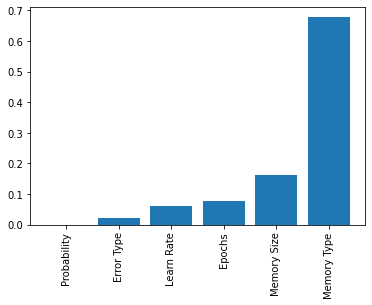

In [112]:
base = "./results_param/"

loc_dirs = [x for x in os.listdir(base) if "." not in x]

place_holder = {
    'CircMem': 0,
    'PriorityMem': 1,
    'NovMSE': 0,
    'NovMAE': 1,
}

x = []
y = []

# model_df = pd.DataFrame(columns=['prob', 'mem_type', 'mem_size', 'error_type', 'epochs', 'rate', 'apv'])

for location in loc_dirs:
    agent_dirs = os.listdir(os.path.join(base, location))

    for agent in agent_dirs:
        if("Curiosity" in agent):
            features = agent.split("_")[:-4]
            y.append(pd.read_csv(os.path.join(base, location, agent, "avg_path_variance.csv"), names=['apv']).apv[0])
            x.append([
                float(features[1].replace('Prob', "")),
                place_holder[features[3]],
                int(features[4].replace("Mem", "")),
                place_holder[features[6]],
                int(features[7].replace("Train", "")),
                float(features[8].replace("Lrate", ""))
            ])
            
model = DecisionTreeRegressor()
model.fit(x, y)

s = sorted(zip(model.feature_importances_,['Probability', 'Memory Type', 'Memory Size', 'Error Type', 'Epochs', 'Learn Rate']))
y, x = list(map(list, zip(*s)))

plt.bar(range(len(y)), y)
plt.xticks(range(len(y)), x, rotation=90)
plt.show()

As we can see from the plot above, the probabilities assigned to each curious agent had almost no effect on the agent's APV. The error type has minimal effect, and the learning rate and epochs have a mild impact. However, the memory size seems to have an immense impact. We believe that this is because curous agents with longer memories are able to avoid locations that they have seen far in the past, and are therefore have a stronger penchant for novelty. The memory type seems to have an extraordinarily large impact, but we believe that this is because of know flaws in the design on the 


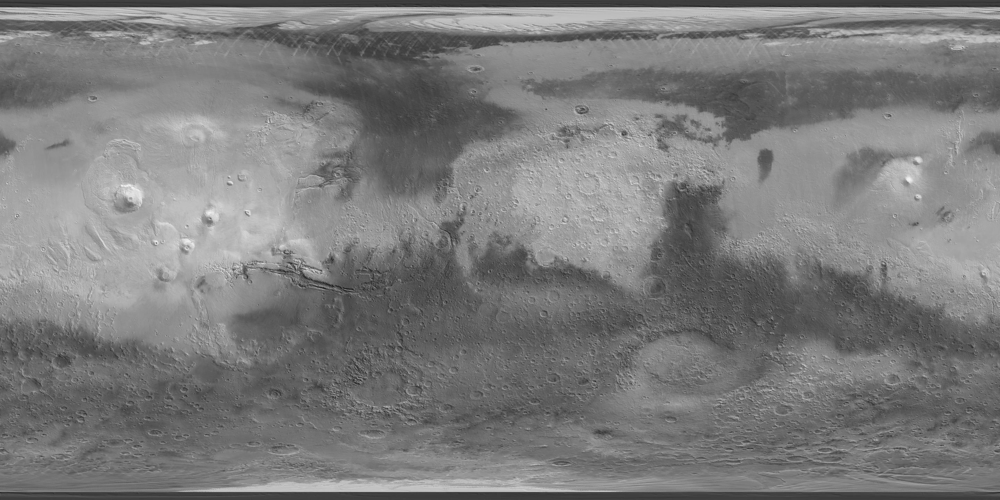

In [143]:
fig = px.imshow(img)

test_fp = "./results_param/pos_574_952/Curiosity_Prob1.0_Brain_PriorityMem_Mem40_ImgSize64_NovMSE_Train3_Lrate0.0004_Agent_Pos_574_952/path_record.csv"
test_df = pd.read_csv(test_fp, names=["x", "y"])
fig.add_trace(go.Scatter(x=test_df.x, y=test_df.y, mode='lines', name="Curiosity_Prob1.0_Brain_PriorityMem_Mem40_ImgSize64_NovMSE_Train3_Lrate0.0004"))

test_fp = "./results_param/pos_574_952/Curiosity_Prob1.0_Brain_PriorityMem_Mem20_ImgSize64_NovMSE_Train3_Lrate0.0004_Agent_Pos_574_952/path_record.csv"
test_df = pd.read_csv(test_fp, names=["x", "y"])
fig.add_trace(go.Scatter(x=test_df.x, y=test_df.y, mode='lines', name='Curiosity_Prob1.0_Brain_PriorityMem_Mem20_ImgSize64_NovMSE_Train3_Lrate0.0004'))

fig.update_layout(
    title={
        text: "Curious Agents",
        xanchor: 'center',
        yanchor: 'top',
        y:0.9,
        x:0.5,
    },
    xaxis_title="X Position",
    yaxis_title="Y Position",
    legend_title={
        text: "Agents",

    },
    legend={
        xanchor: 'center',
        yanchor: 'top',
        y:-0.2,
        x:0.5,
    }
)

fig.show()

In [117]:
test_fp = "./results_param/pos_574_952/Curiosity_Prob1.0_Brain_PriorityMem_Mem40_ImgSize64_NovMSE_Train3_Lrate0.0004_Agent_Pos_574_952/path_record.csv"
test_df = pd.read_csv(test_fp, names=["x", "y"])

fig = px.line_3d(test_df, x=test_df.x, y=test_df.y, z=range(len(test_df)))
fig.show()


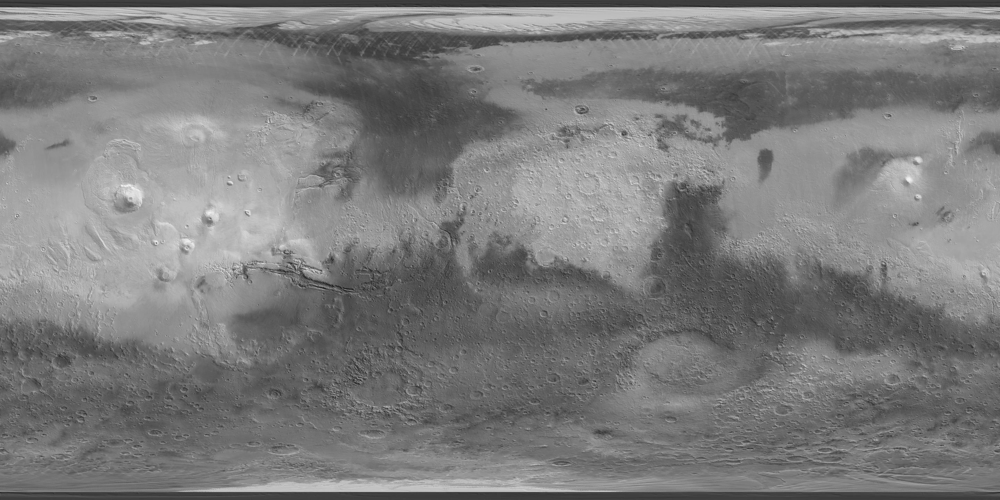

In [24]:
# Display the best, worst, and comparison agents

base = "./results_param"
target_point = 'pos_574_952'
path_record = "path_record.csv"
target_models = [
    'Curiosity_Prob1.0_Brain_CircMem_Mem100_ImgSize64_NovMSE_Train3_Lrate0.0003',
    'Curiosity_Prob1.0_Brain_PriorityMem_Mem20_ImgSize64_NovMAE_Train3_Lrate0.0001',
    'Linear',
    'Random'
]

palette = cycle(px.colors.qualitative.Plotly)

fig = px.imshow(img)

for m in target_models:
    dirname = '{}_Agent_{}'.format(m, target_point[0].upper() + target_point[1:])
    pr = pd.read_csv(os.path.join(base, target_point, dirname, path_record), names=['x', 'y'])
    fig.add_trace(go.Scatter(x=pr.x, y=pr.y, mode='lines', name=m, marker_color=next(palette), hoverlabel= {'namelength' :-1}))

x,y = target_point.split("_")[1:]
fig.add_trace(go.Scatter(x=[x], y=[y], marker_color='black', showlegend=False, name="Starting Point"))

fig.update_layout(
    title={
        'text': "Agents",
        'xanchor': 'center',
        'yanchor': 'top',
        'y':0.97,
        'x':0.5,
    },
    xaxis_title="X Position",
    yaxis_title="Y Position",
    legend_title={
        'text': "Agents",

    },
    legend={
        'xanchor': 'center',
        'yanchor': 'top',
        'y':-0.2,
        'x':0.5,
    },
    width=1000,
    height=1000
)

fig.show()

In [144]:
# Gets the average results for all agents across all locations
base = "./results_param/"

df_agents = pd.DataFrame(columns = ["agent", "apv"])

loc_dirs = [x for x in os.listdir(base) if "." not in x]

for location in loc_dirs:
    agent_dirs = os.listdir(os.path.join(base, location))

    for agent in agent_dirs:
        agent_name = "_".join(agent.split("_")[:-4])

        path = pd.read_csv(os.path.join(base, location, agent, "path_record.csv"), names=['x', 'y'])

         x     y
0     1135  1217
1     1143  1209
2     1151  1201
3     1159  1193
4     1167  1185
...    ...   ...
996   1039  1057
997   1031  1065
998   1039  1057
999   1031  1065
1000  1039  1057

[1001 rows x 2 columns]


In [171]:
plot_path = "./interactive_plots"
os.makedirs(plot_path, exist_ok=True)

# Gets the average results for all agents across all locations
base = "./results_param/"

df_agents = pd.DataFrame(columns = ["agent", "apv"])

loc_dirs = [x for x in os.listdir(base) if "." not in x]

for location in loc_dirs:
    fig = px.imshow(img)

    agent_dirs = os.listdir(os.path.join(base, location))

    palette = cycle(px.colors.cyclical.mrybm)


    for agent in agent_dirs:
        agent_name = "_".join(agent.split("_")[:-4])

        path = pd.read_csv(os.path.join(base, location, agent, "path_record.csv"), names=['x', 'y'])
        fig.add_trace(go.Scatter(x=path.x, y=path.y, mode='lines', name=agent_name, marker_color=next(palette), hoverlabel= {'namelength' :-1}))


    x,y = location.split("_")[1:]
    fig.add_trace(go.Scatter(x=[x], y=[y], marker_color='black', showlegend=False, name="Starting Point"))


    fig.update_layout(
        title={
            'text': "Agents",
            'xanchor': 'center',
            'yanchor': 'top',
            'y':0.97,
            'x':0.5,
        },
        xaxis_title="X Position",
        yaxis_title="Y Position",
        legend_title={
            'text': "Agents",

        },
        legend={
            'xanchor': 'center',
            'yanchor': 'top',
            'y':-0.2,
            'x':0.5,
        },
        width=1000,
        height=1000
    )

    # fig.show()
    fig.write_html(os.path.join(plot_path, "{}.html".format(location)))
    fig.data = []


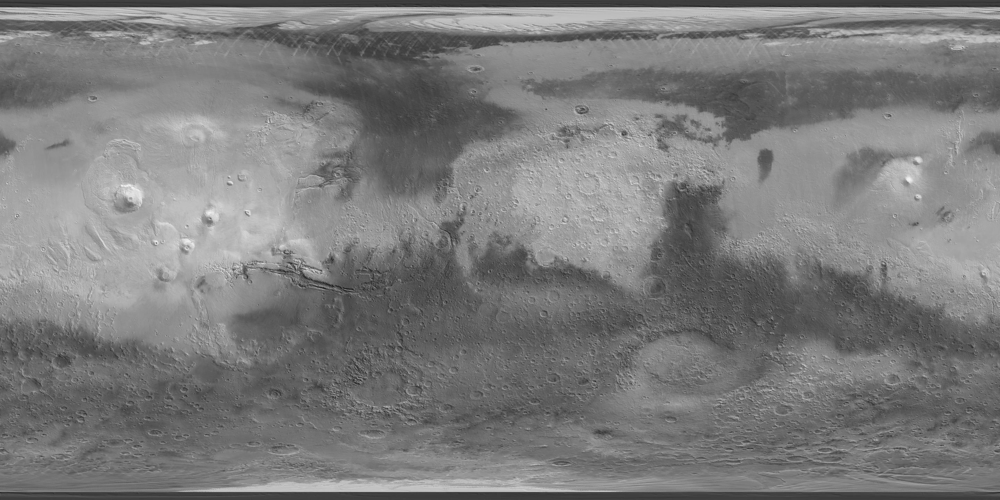

In [230]:
base = "./results_param"
path_record = "path_record.csv"

fig = px.imshow(img)

dirs = [x for x in os.listdir(base) if '.' not in x]
for directory in dirs:
    for _, row in df_ranked_agents.head(1).iterrows():
        path = [x for x in os.listdir(os.path.join(base, directory)) if row['agent'] in x][0]
        pr = pd.read_csv(os.path.join(base, directory, path, path_record), names=['x', 'y'])
        fig.add_trace(go.Scatter(x=pr.x, y=pr.y, mode='lines', name=path, marker_color=next(palette), hoverlabel= {'namelength' :-1}))
    
    # fig.add_trace(go.Scatter(x=[x], y=[y], marker_color='black', showlegend=False, name="Starting Point"))

fig.update_layout(
    title={
        'text': "Agents",
        'xanchor': 'center',
        'yanchor': 'top',
        'y':0.97,
        'x':0.5,
    },
    xaxis_title="X Position",
    yaxis_title="Y Position",
    legend_title={
        'text': "Agents",

    },
    legend={
        'xanchor': 'center',
        'yanchor': 'top',
        'y':-0.2,
        'x':0.5,
    },
    width=1000,
    height=1000
)

fig.show()
    # break
    # fig.write_html(os.path.join(plot_path, "{}.html".format(location)))
    # fig.data = []

In [279]:
def get_concat_h(im1, im2):
    dst = Image.new('RGB', (im1.width + im2.width, im1.height))
    dst.paste(im1, (0, 0))
    dst.paste(im2, (im1.width, 0))
    return dst

source = "./results_param/pos_574_952/Curiosity_Prob1.0_Brain_CircMem_Mem40_ImgSize64_NovMAE_Train3_Lrate0.0004_Agent_Pos_574_952/snapshots"
destination = os.path.abspath('./test.gif')

originals = [x for x in os.listdir(source) if 'orig' in x]
predicteds = [x for x in os.listdir(source) if 'pred' in x]

concatinated = []

for o,p in zip(originals, predicteds):
    orig = Image.open(os.path.join(source, o))
    pred = Image.open(os.path.join(source, p))
    concatinated.append(np.array(get_concat_h(orig, pred)))

clip = mpy.ImageSequenceClip(concatinated, fps=3)
clip.write_gif('out.gif', fps=3)


t:  48%|████▊     | 10/21 [00:00<00:00, 99.99it/s, now=None]MoviePy - Building file out.gif with imageio.
